**Table of contents**<a id='toc0_'></a>    
- [Cleaned Analysis of June 15th 2022 Flight at 100 Hz](#toc1_)    
  - [Purpose:](#toc1_1_)    
  - [Methods:](#toc1_2_)    
  - [Results](#toc1_3_)    
  - [Naming and Folders](#toc1_4_)    
  - [Importing Packages and Libraries](#toc1_5_)    
  - [Importing Data](#toc1_6_)    
  - [Defining Vehicle Parameters](#toc1_7_)    
  - [Manually Selecting Mask by Plots](#toc1_8_)    
    - [Results of Manual Segmentation](#toc1_8_1_)    
      - [Cruise Segmentation](#toc1_8_1_1_)    
        - [Checking Segments for Good Data](#toc1_8_1_1_1_)    
      - [Glide Segmentation](#toc1_8_1_2_)    
  - [Main Analysis](#toc1_9_)    
    - [Methods:](#toc1_9_1_)    
    - [Collecting Averages and Standard Deviations from Segments](#toc1_9_2_)    
    - [Collecting Total Data-points from Segments](#toc1_9_3_)    
  - [Collecting Data into Bins](#toc1_10_)    
  - [Plotting Results of Bin and Segments](#toc1_11_)    
  - [Performing Curve Fits to Find Polars](#toc1_12_)    
  - [Packaging the Results](#toc1_13_)    
  - [Saving Results to Disk](#toc1_14_)    
  - [Additional Plots](#toc1_15_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Cleaned Analysis of June 15th 2022 Flight at 100 Hz](#toc0_)

## <a id='toc1_1_'></a>[Purpose:](#toc0_)
* Use more up to date code to run analysis
* Make sure the same equations are being used as for other analysis

## <a id='toc1_2_'></a>[Methods:](#toc0_)
Both the cruise and glides methods can be applied to this data-set

## <a id='toc1_3_'></a>[Results](#toc0_)
Glide methods are offset from the cruise methods.  Overall the cruise data is very consistent, and is better than the June 13th data.  

## <a id='toc1_4_'></a>[Naming and Folders](#toc0_)

In [1]:
### Definining name of analysis ###
name = '2022-06-15_CREATeV_Cruise_Analysis_Cleaned'
data_path = '../../data/'
data_folder = 'createv-2022-06-15'
file_name = 'june15_2022.BIN'
datasave_path = data_path+data_folder+'/'
result_path = '../Results/'+name+'/'
figure_path = '../Figures/'+name+'/'

## <a id='toc1_5_'></a>[Importing Packages and Libraries](#toc0_)

In [2]:
from os import sys
import os
sys.path.append('../../')

%matplotlib widget

from matplotlib import pyplot as plt
import plotly.express as px
import numpy as np
import pandas as pd

import main
from main import flight
from main import analysis
import propellers
import motors
from aircraft import airplane
import cl_finders

## Creating Folders for Results/Data ###
if not os.path.exists(result_path):
    os.makedirs(result_path)
if not os.path.exists(figure_path):
    os.makedirs(figure_path)
if not os.path.exists(data_path+data_folder):
    os.makedirs(data_path+data_folder)

# Setting Plot Defaults
plt.style.use('../../basic_plotter.mplstyle')

## <a id='toc1_6_'></a>[Importing Data](#toc0_)

In [3]:
# Importing data, specifying import characteristics, backing up results
rate = "10ms"
interpolateM = "linear"
processor = "CREATeV_2022"
df = main.data_load(data_path, data_folder, file_name, rate, interpolateM, processor)

## <a id='toc1_7_'></a>[Defining Vehicle Parameters](#toc0_)

In [4]:
# Vehicle parameters
prop = propellers.aeronaut185x12() # Using aeronaut 18.5 x 12
motor = motors.U7V2_280KV()  # Using U7 V2 motor

mass = 12.7275 # Mass adjusted for new propeller
span = 6.28
chord = 0.395
createv = airplane(mass, chord, span)

## <a id='toc1_8_'></a>[Manually Selecting Mask by Plots](#toc0_)

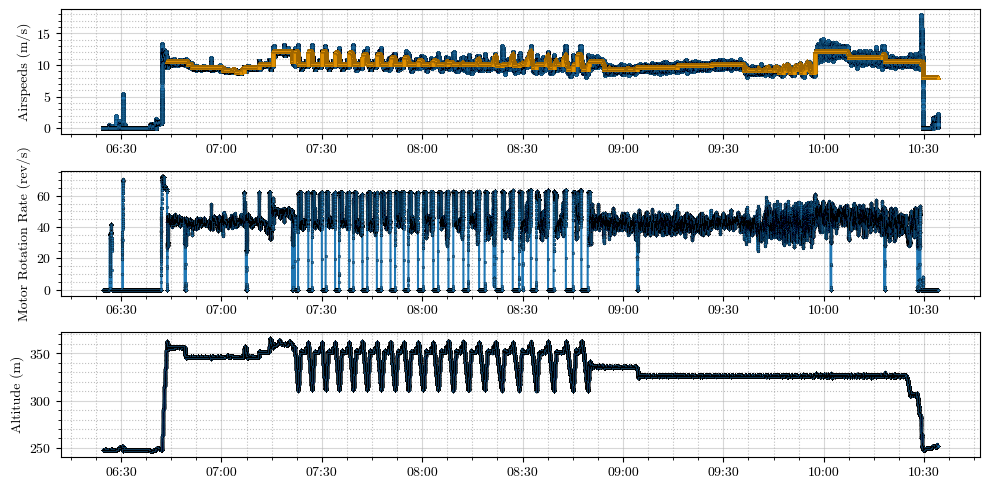

Plot already exists


In [5]:
# Plotting Airspeed for Establishing Cruising Time Intervals
timeindex_v_rpm_h = plt.figure(figsize=(10,5), dpi=100)
ax1 = plt.subplot(3,1,1)
ax1.plot(df.index, df.Airspeed_Sensor0, label="Airspeed", marker='o', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=0.1)
ax1.plot(df.index, df.Airspeed_Demanded, label="Demanded Airspeed", color='orange', marker='^', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=0.05)
ax1.set_ylabel("Airspeeds (m/s)")
ax1.grid(which='major', linestyle='-')
ax1.grid(which='minor', linestyle=':', color='grey')
#plt.legend()

ax2 = plt.subplot(3,1,2, sharex=ax1)
ax2.plot(df.index, df.MotorRPM/60, label='ESC Measurement')
ax2.set_ylabel("Motor Rotation Rate (rev/s)")
ax2.grid(which='major', linestyle='-')
ax2.grid(which='minor', linestyle=':', color='grey')
#plt.legend()

ax3 = plt.subplot(3,1,3, sharex=ax1)
ax3.plot(df.index, df.Altitude_POS, label='Altitude')
ax3.set_ylabel("Altitude (m)")
ax3.grid(which='major', linestyle='-')
ax3.grid(which='minor', linestyle=':', color='grey')
#plt.legend()

plt.show()
main.save_figure(timeindex_v_rpm_h, f'{timeindex_v_rpm_h=}'.split('=')[0], figure_path)

### <a id='toc1_8_1_'></a>[Results of Manual Segmentation](#toc0_)

#### <a id='toc1_8_1_1_'></a>[Cruise Segmentation](#toc0_)

In [6]:
seg_times = np.array([['08:54:36','09:04:09'],
                      ['09:04:36','09:16:09'],
                      ['09:16:11','09:26:10'],
                      ['09:26:10','09:36:09'],
                      ['09:57:40','10:02:04'],
                      ['10:02:14','10:07:21'],
                      ['10:07:29','10:17:21'],
                      ['10:18:25','10:24:34'],
                      ['10:25:52','10:27:55']])

year = 2022
month = 6
day = 15

masks = cl_finders.get_maskarray(df, seg_times, year, month, day)

##### <a id='toc1_8_1_1_1_'></a>[Checking Segments for Good Data](#toc0_)

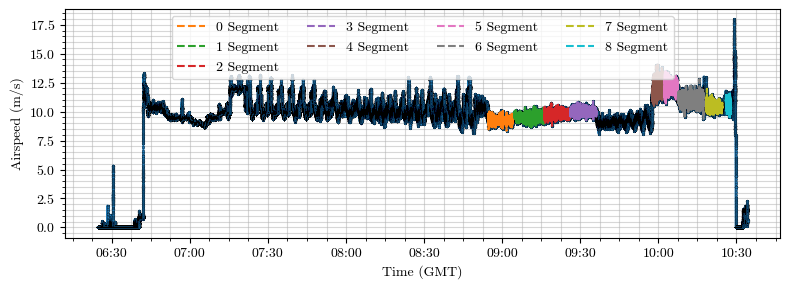

Plot already exists


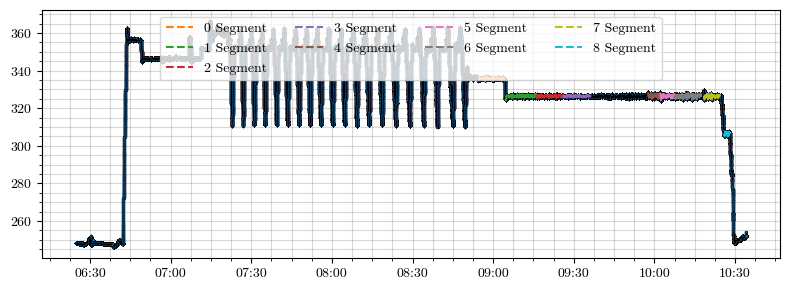

Plot already exists


In [7]:
# Airspeed for Segments
timeindex_v_segmented = plt.figure(figsize=(8,3), dpi=100)
plt.plot(df.index, df.Airspeed_Sensor0)
for i in np.arange(len(masks)):
    plt.plot(df.Airspeed_Sensor0[masks[i]], marker='', linestyle='--', label=str(i) + " Segment")
plt.ylabel("Airspeed (m/s)")
plt.xlabel("Time (GMT)")
plt.legend(loc='upper center',
          ncol=4, fancybox=True)
plt.tight_layout()
plt.show()
main.save_figure(timeindex_v_segmented, f'{timeindex_v_segmented=}'.split('=')[0], figure_path)

# Altitude for Segments
timeindex_h_segmented = plt.figure(figsize=(8,3), dpi=100)
plt.plot(df.index, df.Altitude_POS)
for i in np.arange(len(masks)):
    plt.plot(df.Altitude_POS[masks[i]], marker='', linestyle='--', label=str(i) + " Segment")
plt.legend(loc='upper center',
          ncol=4, fancybox=True)
plt.tight_layout()
plt.show()
main.save_figure(timeindex_h_segmented, f'{timeindex_h_segmented=}'.split('=')[0], figure_path)

Font 'default' does not have a glyph for '\\times' [U+d7], substituting with a dummy symbol.
Font 'default' does not have a glyph for '\\times' [U+d7], substituting with a dummy symbol.
Font 'default' does not have a glyph for '\\times' [U+d7], substituting with a dummy symbol.
Font 'default' does not have a glyph for '\\times' [U+d7], substituting with a dummy symbol.


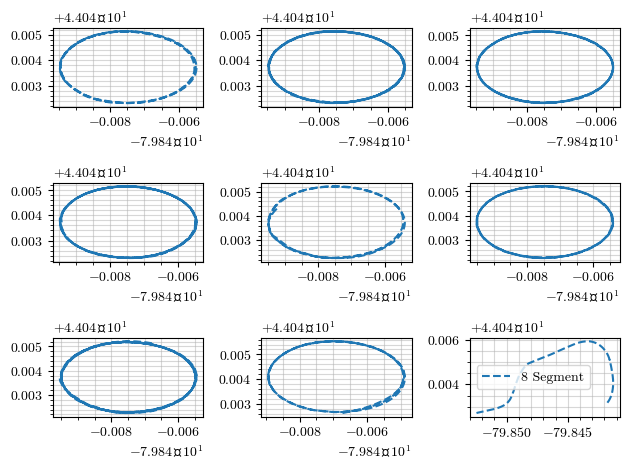

In [8]:
fig, axs = plt.subplots(3, 3)
axs = axs.flatten()
for i in np.arange(0,9):
    axs[i].plot(df.Longitude[masks[i]], df.Latitude[masks[i]], marker='', linestyle='--', label=str(i) + " Segment")
plt.legend()
plt.show()

Notes on the Selected Intervals
* Airspeed discontinuities in Segments 4 and 5, possible to skew results, but average should help
* Altitude was different for the first and last segments from all the other segments 
* Last interval was not a circular flight path, so should probably be removed!!

#### <a id='toc1_8_1_2_'></a>[Glide Segmentation](#toc0_)

In [9]:
seg_times = np.array([['07:22:05','07:22:53'],
                      ['07:26:03','07:27:00'],
                      ['07:30:07','07:31:07'],
                      ['07:34:02','07:35:07'],
                      ['07:38:15','07:39:23'],
                      ['07:42:09','07:43:33'],
                      ['07:46:31','07:47:44'],
                      ['07:50:35','07:51:52'],
                      ['07:54:31','07:55:52'],
                      ['07:58:44','08:00:17'],
                      ['08:03:18','08:04:43'],
                      ['08:07:50','08:09:15'],
                      ['08:12:18','08:13:46'],
                      ['08:17:13','08:18:37'],
                      ['08:22:27','08:23:45'],
                      ['08:27:36','08:28:54'],
                      ['08:33:13','08:34:06'],
                      ['08:38:18','08:39:14'],
                      ['08:43:38','08:44:59'],
                      ['08:48:03','08:49:26']])

year = 2022
month = 6
day = 15

desc_masks = cl_finders.get_maskarray(df, seg_times, year, month, day)

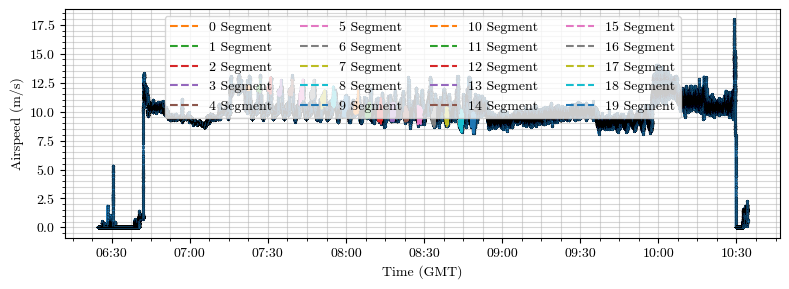

Plot already exists


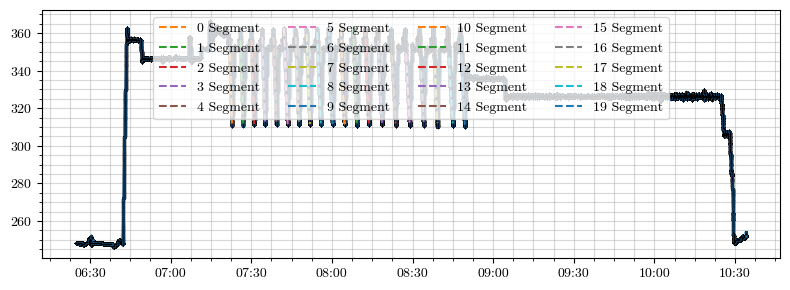

Plot already exists


In [10]:
# Airspeed for Segments
timeindex_v_segmented_desc = plt.figure(figsize=(8,3), dpi=100)
plt.plot(df.index, df.Airspeed_Sensor0)
for i in np.arange(len(desc_masks)):
    plt.plot(df.Airspeed_Sensor0[desc_masks[i]], marker='', linestyle='--', label=str(i) + " Segment")
plt.ylabel("Airspeed (m/s)")
plt.xlabel("Time (GMT)")
plt.legend(loc='upper center',
          ncol=4, fancybox=True)
plt.tight_layout()
plt.show()
main.save_figure(timeindex_v_segmented_desc, f'{timeindex_v_segmented_desc=}'.split('=')[0], figure_path)

# Altitude for Segments
timeindex_h_segmented = plt.figure(figsize=(8,3), dpi=100)
plt.plot(df.index, df.Altitude_POS)
for i in np.arange(len(desc_masks)):
    plt.plot(df.Altitude_POS[desc_masks[i]], marker='', linestyle='--', label=str(i) + " Segment")
plt.legend(loc='upper center',
          ncol=4, fancybox=True)
plt.tight_layout()
plt.show()
main.save_figure(timeindex_v_segmented_desc, f'{timeindex_v_segmented_desc=}'.split('=')[0], figure_path)

Notes on the Selected Intervals
* Later segments had difficulty maintaining airspeed during the descents
* Due to the sun rising, more wind etc. 
* Selections are good for the glide start and end, as well as airspeed settled

## <a id='toc1_9_'></a>[Main Analysis](#toc0_)

### <a id='toc1_9_1_'></a>[Methods:](#toc0_)
1. Cruise Thrust Method
2. Cruise efficiency Method
3. Gliding Method

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_80139/2231668188.py:6: RuntimeWarning: invalid value encountered in reciprocal
  rho = df["Pressure"].to_numpy() * (287 * (df["Ambient_Temperature"].to_numpy()+273.15))**-1             # Density found from barometer pressure & airspeed sensor temperatures
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_80139/2231668188.py:8: RuntimeWarning: invalid value encountered in reciprocal
  v_tas = v_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_80139/2231668188.py:14: RuntimeWarning: invalid value encountered in reciprocal
  Vd_tas = Vd_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_80139/2231668188.py:20: RuntimeWarning: divide by zero encountered in true_divide
  J = v_tas / (n * prop.diameter)
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_80139/2231668188.py:20: 

Freewheel thrust coefficient:  -0.00804445463199624 
 Advance Ratio:  0.8386905840958647 
 CP Freewheel:  5.129680916149404e-10


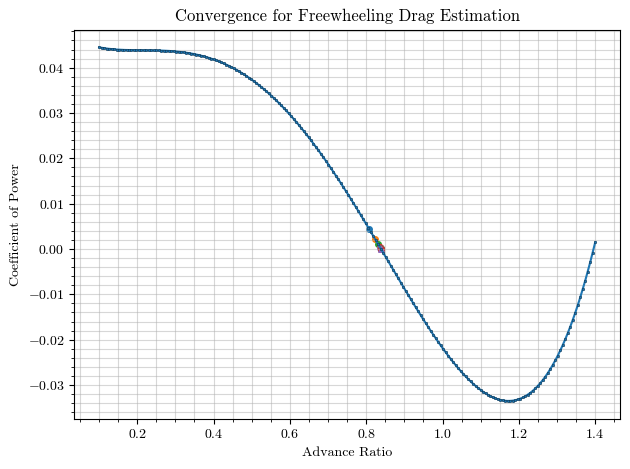

Propeller Drag[nan nan nan ...  0.  0.  0.]


/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_CREATeV_Performance_Analysis/../../cl_finders.py:217: RuntimeWarning: divide by zero encountered in reciprocal
  CD = p_required * (q * v * aircraft.area)**-1
/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_CREATeV_Performance_Analysis/../../cl_finders.py:217: RuntimeWarning: invalid value encountered in reciprocal
  CD = p_required * (q * v * aircraft.area)**-1
/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_CREATeV_Performance_Analysis/../../cl_finders.py:217: RuntimeWarning: invalid value encountered in multiply
  CD = p_required * (q * v * aircraft.area)**-1
/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_CREATeV_Performance_Analysis/../../cl_finders.py:119: RuntimeWarning: divide by zero encountered in reciprocal
  CL = aircraft.weight * (np.cos(phi) * q * aircraft.area)**-1
/

In [11]:
############# Main Analysis ###############3
# Attitude 
phi = np.deg2rad(df["RollAngle"].to_numpy())            # Bank angle in radians

# Atmospheric adjustments:
rho = df["Pressure"].to_numpy() * (287 * (df["Ambient_Temperature"].to_numpy()+273.15))**-1             # Density found from barometer pressure & airspeed sensor temperatures
v_eas = df["Airspeed_Sensor0"].to_numpy()                               # Equivalent SSL airspeed (m/s)
v_tas = v_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed
q = 0.5 * rho * v_tas**2                            # Dynamic pressure 

# For Descent method
h = df["Altitude_POS"].to_numpy()                   # Altitude
Vd_eas = df["DescendingXK"].to_numpy()                  # Descent Rate from EKF (is it true or EAS at SSL?)
Vd_tas = Vd_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed

# Propulsion characterization
n = df["MotorRPM"].to_numpy() / 60                               # Revolutions per second
i_esc = df["EscCurrent"].to_numpy()
v_esc = df["EscVoltage"].to_numpy()
J = v_tas / (n * prop.diameter)
eff = prop.efficiency(J) * motor.efficiency(n, i_esc)

# Estimated propulsive power (New Fitting)
P_eta = cl_finders.eta_steady(prop, motor, v_tas, n, i_esc, v_esc)
P_ct = cl_finders.thrust_steady(prop, rho, v_tas, n)
P_desc = cl_finders.desc2preq(createv, prop, rho, v_tas, n, q, Vd_tas)

# Getting drag coefficient
Cd_eta = cl_finders.preq2cd(createv, v_tas, q, P_eta)
Cd_ct = cl_finders.preq2cd(createv, v_tas, q, P_ct)
Cd_desc = cl_finders.preq2cd(createv, v_tas, q, P_desc)

# Getting lift coefficient
CL = cl_finders.cl_banked(createv, q, phi)

### <a id='toc1_9_2_'></a>[Collecting Averages and Standard Deviations from Segments](#toc0_)

In [12]:
[cl_means_eta, cl_stds_eta, cl_ci95s_eta, cd_means_eta, cd_stds_eta, cd_ci95s_eta] = cl_finders.collect_segments(masks, CL, Cd_eta)
[cl_means_ct, cl_stds_ct, cl_ci95s_ct, cd_means_ct, cd_stds_ct, cd_ci95s_ct] = cl_finders.collect_segments(masks, CL, Cd_ct)

[cl_means_desc, cl_stds_desc, cl_ci95s_desc, cd_means_desc, cd_stds_desc, cd_ci95s_desc] = cl_finders.collect_segments(desc_masks, CL, Cd_desc)

### <a id='toc1_9_3_'></a>[Collecting Total Data-points from Segments](#toc0_)

In [13]:
# Totalling up CL, CD for Cruise
cl_total_cruise = cl_finders.total_segments_boolean(CL, masks)
cd_total_eta = cl_finders.total_segments_boolean(Cd_eta, masks)
cd_total_ct = cl_finders.total_segments_boolean(Cd_ct, masks)

cl_total_desc = cl_finders.total_segments_boolean(CL, desc_masks)
cd_total_desc = cl_finders.total_segments_boolean(Cd_desc, desc_masks)

## <a id='toc1_10_'></a>[Collecting Data into Bins](#toc0_)

In [14]:
bins = np.linspace(0.05, 1.1, 51)
[cl_means_eta_bin, cl_stds_eta_bin, cl_ci95s_eta_bin, cd_means_eta_bin, cd_stds_eta_bin, cd_ci95s_eta_bin] = cl_finders.collect_bins(bins, cl_total_cruise, cd_total_eta)
[cl_means_ct_bin, cl_stds_ct_bin, cl_ci95s_ct_bin, cd_means_ct_bin, cd_stds_ct_bin, cd_ci95s_ct_bin] = cl_finders.collect_bins(bins, cl_total_cruise, cd_total_ct)
[cl_means_desc_bin, cl_stds_desc_bin, cl_ci95s_desc_bin, cd_means_desc_bin, cd_stds_desc_bin, cd_ci95s_desc_bin] = cl_finders.collect_bins(bins, cl_total_desc, cd_total_desc)

/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_CREATeV_Performance_Analysis/../../cl_finders.py:415: RuntimeWarning: Mean of empty slice.
  cl_means = [total_lift_coeffs[digitized == i].mean() for i in range(1, len(bins))]
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/p

## <a id='toc1_11_'></a>[Plotting Results of Bin and Segments](#toc0_)

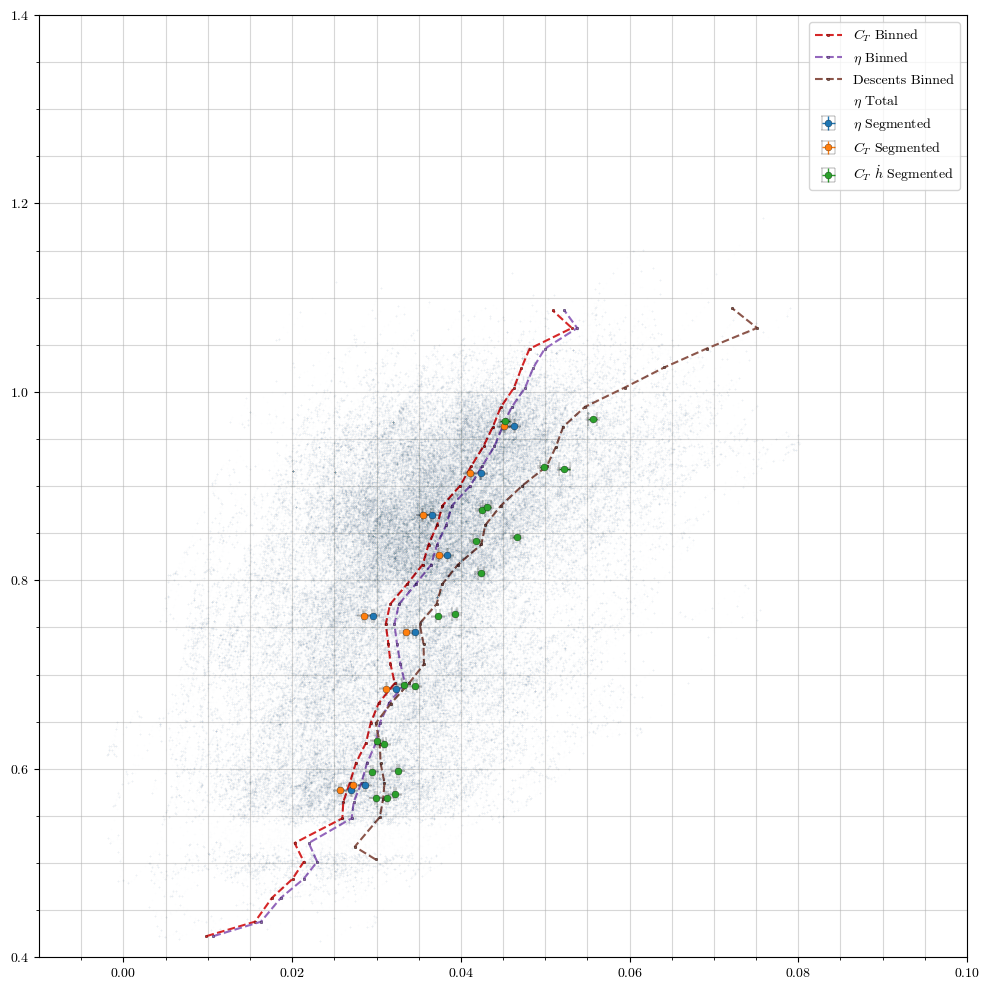

Plot already exists


In [15]:
CruiseDescPolar_RawANDsegmented = plt.figure(figsize=(10,10), dpi=100)
plt.errorbar(cd_means_eta, cl_means_eta, xerr=cd_ci95s_eta, yerr=cl_ci95s_eta, linestyle='', markersize = 10, capsize=5, elinewidth=1, label="$\eta$ Segmented")
plt.errorbar(cd_means_ct, cl_means_ct, xerr=cd_ci95s_ct, yerr=cl_ci95s_ct, linestyle='', markersize = 10, capsize=5, elinewidth=1, label="$C_T$ Segmented")
plt.errorbar(cd_means_desc, cl_means_desc, xerr=cd_ci95s_desc, yerr=cl_ci95s_desc, linestyle='', markersize = 10, capsize=5, elinewidth=1, label="$C_T$ $\dot{h}$ Segmented")
plt.plot(cd_means_ct_bin, cl_means_ct_bin, linestyle='--', label="$C_T$ Binned")
plt.plot(cd_means_eta_bin, cl_means_eta_bin, linestyle='--', label="$\eta$ Binned")
plt.plot(cd_means_desc_bin, cl_means_desc_bin, linestyle='--', label="Descents Binned")


plt.plot(cd_total_ct, cl_total_cruise, linestyle='', color="C{}".format(0), alpha=0.01, marker='.', markersize=2, label="$\eta$ Total")
plt.xlim([-0.01, 0.1])
plt.ylim([0.4, 1.4])
plt.legend()
plt.show()
main.save_figure(CruiseDescPolar_RawANDsegmented, f'{CruiseDescPolar_RawANDsegmented=}'.split('=')[0], figure_path)

## <a id='toc1_12_'></a>[Performing Curve Fits to Find Polars](#toc0_)

In [16]:
polar_eta = cl_finders.cd2polar(createv, cd_means_eta, cl_means_eta, highorder=False)
polar_ct = cl_finders.cd2polar(createv, cd_means_ct, cl_means_ct, highorder=False)
polar_desc = cl_finders.cd2polar(createv, cd_means_desc, cl_means_desc, highorder=False)

polar_eta_bin = cl_finders.cd2polar(createv, cd_means_eta_bin, cl_means_eta_bin, highorder=False)
polar_ct_bin = cl_finders.cd2polar(createv, cd_means_ct_bin, cl_means_ct_bin, highorder=False)
polar_desc_bin = cl_finders.cd2polar(createv, cd_means_desc_bin, cl_means_desc_bin, highorder=False)

print(polar_eta)
print(polar_ct)
print(polar_desc)

print(polar_eta_bin)
print(polar_ct_bin)
print(polar_desc_bin)

0.17807389968668486
0.1814960984922529
0.23534148587261328
0.6261561106394491
0.6274597641988058
0.5624355353425841
[0.01741609 0.68976881]
[0.01606629 0.68270352]
[0.0182745  0.56851252]
[0.01381712 0.59137264]
[0.01269192 0.59314082]
[0.01180447 0.42342933]


## <a id='toc1_13_'></a>[Packaging the Results](#toc0_)

In [17]:
eta_cruise_segresult = cl_finders.packaging_binresults(cl_total_cruise, cl_means_eta, cl_stds_eta, cl_ci95s_eta, cd_total_eta, cd_means_eta, cd_stds_eta, cd_ci95s_eta, polar_eta, createv)
ct_cruise_segresult = cl_finders.packaging_binresults(cl_total_cruise, cl_means_ct, cl_stds_ct, cl_ci95s_ct, cd_total_ct, cd_means_ct, cd_stds_ct, cd_ci95s_ct, polar_ct, createv)
desc_segresult = cl_finders.packaging_binresults(cl_total_desc, cl_means_desc, cl_stds_desc, cl_ci95s_desc, cd_total_desc, cd_means_desc, cd_stds_desc, cd_ci95s_desc, polar_desc, createv)

eta_cruise_binresult = cl_finders.packaging_binresults(cl_total_cruise, cl_means_eta_bin, cl_stds_eta_bin, cl_ci95s_eta_bin, cd_total_eta, cd_means_eta_bin, cd_stds_eta_bin, cd_ci95s_eta_bin, polar_eta_bin, createv)
ct_cruise_binresult = cl_finders.packaging_binresults(cl_total_cruise, cl_means_ct_bin, cl_stds_ct_bin, cl_ci95s_ct_bin, cd_total_ct, cd_means_ct_bin, cd_stds_ct_bin, cd_ci95s_ct_bin, polar_ct_bin, createv)
desc_binresult = cl_finders.packaging_binresults(cl_total_desc, cl_means_desc_bin, cl_stds_desc_bin, cl_ci95s_desc_bin, cd_total_desc, cd_means_desc_bin, cd_stds_desc_bin, cd_ci95s_desc_bin, polar_desc_bin, createv)

## <a id='toc1_14_'></a>[Saving Results to Disk](#toc0_)

In [18]:
# Saving results to their pickles
pd.to_pickle(eta_cruise_segresult, result_path+'eta_cruise_segresult.pkl')
pd.to_pickle(ct_cruise_segresult, result_path+'ct_cruise_segresult.pkl')
pd.to_pickle(desc_segresult, result_path+'desc_segresult.pkl')

pd.to_pickle(eta_cruise_binresult, result_path+'eta_cruise_binresult.pkl')
pd.to_pickle(ct_cruise_binresult, result_path+'ct_cruise_binresult.pkl')
pd.to_pickle(desc_binresult, result_path+'desc_binresult.pkl')

## <a id='toc1_15_'></a>[Additional Plots](#toc0_)

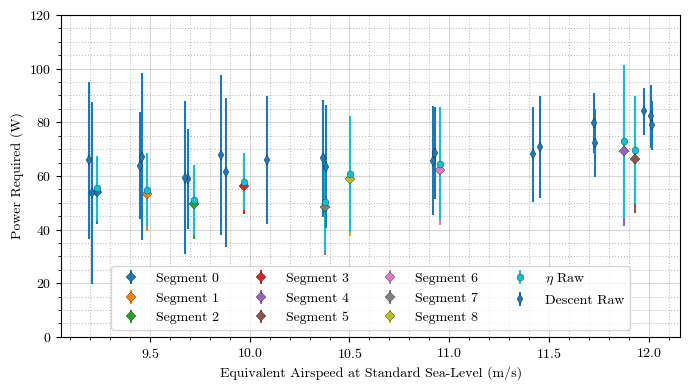

In [19]:
# Plot of Power Required Fits and Data #

[Pave_ct, EAS_Ct] = cl_finders.rawpolar2preqew(createv, cl_means_ct, cd_means_ct)
[Pave_eta, EAS_eta] = cl_finders.rawpolar2preqew(createv, cl_means_eta, cd_means_eta)
[Pave_desc, EAS_desc] = cl_finders.rawpolar2preqew(createv, cl_means_desc, cd_means_desc)

CTPolar_SegmentedwBadData = plt.figure(figsize=(7,4), dpi=100)
for i in range(len(masks)):
    plt.errorbar(EAS_Ct[i], Pave_ct[i], yerr=cd_stds_ct[i]*0.5*1.225*createv.area*EAS_Ct[i]**3 , label="Segment "+str(i), linestyle='', marker='D', markersize=5)
plt.errorbar(EAS_eta, Pave_eta, yerr=cd_stds_eta*0.5*1.225*createv.area*EAS_eta**3 , label="$\eta$ Raw", linestyle='', marker='o', markersize=5)
plt.errorbar(EAS_desc, Pave_desc, yerr=cd_stds_desc*0.5*1.225*createv.area*EAS_desc**3 , label="Descent Raw", linestyle='', marker='d', markersize=5)

plt.xlabel("Equivalent Airspeed at Standard Sea-Level (m/s)")
plt.ylabel("Power Required (W)")
plt.ylim([0, 120])
plt.legend(loc='lower center', ncol=4)
plt.grid(which='major', linestyle='-')
plt.grid(which='minor', linestyle=':', color='grey')
plt.minorticks_on()
plt.tight_layout()
plt.show()
main.save_figure(CTPolar_SegmentedwBadData, f'{CTPolar_SegmentedwBadData=}'.split('=')[0], figure_path, overwrite=True)

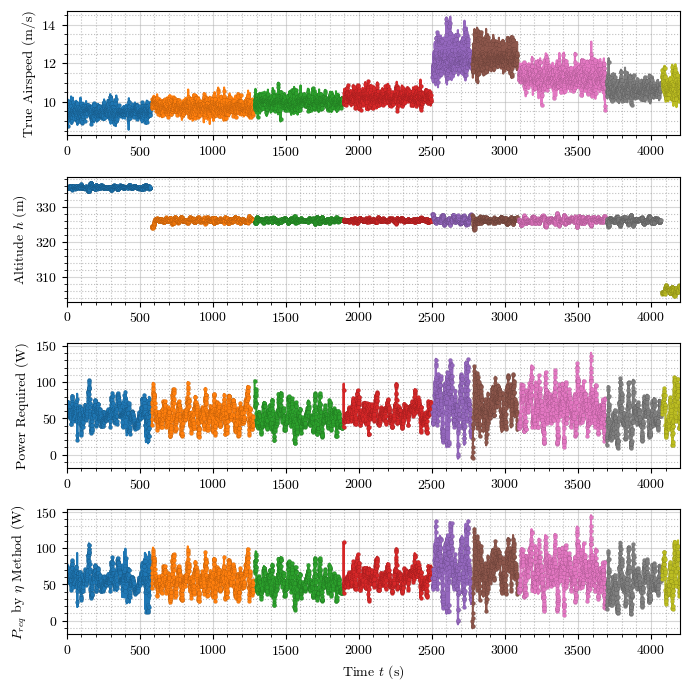

Plot already exists


In [20]:
# Plotting Steady-level Data Runs #
markerstyle = 'o'
markerevery = 80
markedgew = 0.05
timeindex_v_h_Pct_Peta = plt.figure(figsize=(7,7))
ax1 = plt.subplot(4,1,1)
t_init = 0
for i in range(len(masks)):
    time_s = np.linspace(t_init, (len(v_tas[masks[i]])-1)/100 + t_init, len(v_tas[masks[i]]))
    ax1.plot(time_s, v_tas[masks[i]], marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax1.set_ylabel("True Airspeed (m/s)")
ax1.grid(which='major', linestyle='-')
ax1.grid(which='minor', linestyle=':', color='grey')
ax1.autoscale(enable=True, axis='x', tight=True)

ax0 = plt.subplot(4,1,2, sharex=ax1)
t_init = 0
for i in range(len(masks)):
    time_s = np.linspace(t_init, (len(v_tas[masks[i]])-1)/100 + t_init, len(v_tas[masks[i]]))
    ax0.plot(time_s, h[masks[i]], marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax0.set_ylabel("Altitude $h$ (m)")
ax0.grid(which='major', linestyle='-')
ax0.grid(which='minor', linestyle=':', color='grey')
ax0.autoscale(enable=True, axis='x', tight=True)

ax2 = plt.subplot(4,1,3, sharex=ax1)
t_init = 0
for i in range(len(masks)):
    time_s = np.linspace(t_init, (len(v_tas[masks[i]])-1)/100 + t_init, len(v_tas[masks[i]]))
    ax2.plot(time_s, P_ct[masks[i]], marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax2.set_ylabel("Power Required (W)")
ax2.grid(which='major', linestyle='-')
ax2.grid(which='minor', linestyle=':', color='grey')
ax2.autoscale(enable=True, axis='x', tight=True)

ax3 = plt.subplot(4,1,4, sharex=ax1, sharey=ax2)
t_init = 0
for i in range(len(masks)):
    time_s = np.linspace(t_init, (len(v_tas[masks[i]])-1)/100 + t_init, len(v_tas[masks[i]]))
    ax3.plot(time_s, P_eta[masks[i]], marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax3.set_ylabel("$P_{req}$ by $\eta$ Method (W)")
ax3.set_xlabel("Time $t$ (s)")
ax3.grid(which='major', linestyle='-')
ax3.grid(which='minor', linestyle=':', color='grey')
ax3.autoscale(enable=True, axis='x', tight=True)

plt.tight_layout()
plt.show()
main.save_figure(timeindex_v_h_Pct_Peta, f'{timeindex_v_h_Pct_Peta=}'.split('=')[0], figure_path)

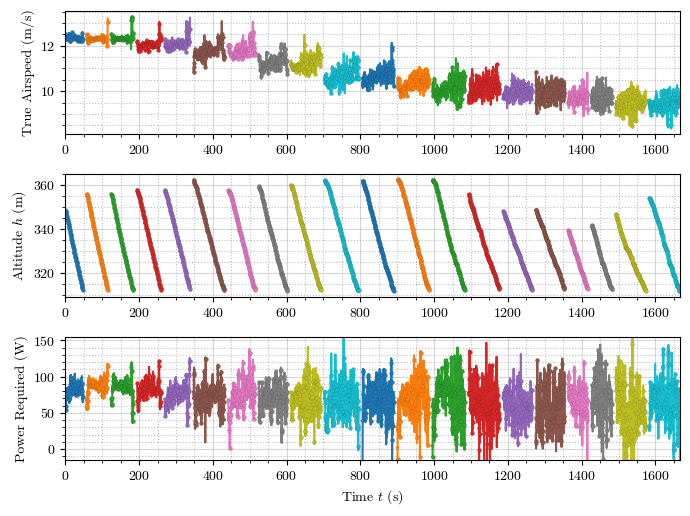

Plot already exists


In [21]:
# Plotting Descending Data Runs #
markerstyle = 'o'
markerevery = 80
markedgew = 0.05


timeindex_v_h_Pdesc = plt.figure(figsize=(7,5.25))
ax1 = plt.subplot(3,1,1)
t_init = 0
for i in range(len(desc_masks)):
    time_s = np.linspace(t_init, (len(v_tas[desc_masks[i]])-1)/100 + t_init, len(v_tas[desc_masks[i]]))
    ax1.plot(time_s, v_tas[desc_masks[i]], marker=markerstyle, markevery=markerevery, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax1.set_ylabel("True Airspeed (m/s)")
ax1.grid(which='major', linestyle='-')
ax1.grid(which='minor', linestyle=':', color='grey')
ax1.autoscale(enable=True, axis='x', tight=True)


ax2 = plt.subplot(3,1,2, sharex=ax1)
t_init = 0
for i in range(len(desc_masks)):
    time_s = np.linspace(t_init, (len(v_tas[desc_masks[i]])-1)/100 + t_init, len(v_tas[desc_masks[i]]))
    ax2.plot(time_s, h[desc_masks[i]], marker=markerstyle, markevery=markerevery, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax2.set_ylabel("Altitude $h$ (m)")
ax2.grid(which='major', linestyle='-')
ax2.grid(which='minor', linestyle=':', color='grey')
ax2.autoscale(enable=True, axis='x', tight=True)


ax3 = plt.subplot(3,1,3, sharex=ax2)
t_init = 0
for i in range(len(desc_masks)):
    time_s = np.linspace(t_init, (len(v_tas[desc_masks[i]])-1)/100 + t_init, len(v_tas[desc_masks[i]]))
    ax3.plot(time_s, P_desc[desc_masks[i]], marker=markerstyle, markevery=markerevery, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew)
    t_init = time_s[-1]+10
ax3.set_ylabel("Power Required (W)")
ax3.set_xlabel("Time $t$ (s)")
ax3.set_ylim([-15, 155])
ax3.grid(which='major', linestyle='-')
ax3.grid(which='minor', linestyle=':', color='grey')
ax3.autoscale(enable=True, axis='x', tight=True)

plt.tight_layout()
plt.show()
main.save_figure(timeindex_v_h_Pdesc, f'{timeindex_v_h_Pdesc=}'.split('=')[0], figure_path)

In [22]:
## Generating Map Plots Descending ## 
token = "pk.eyJ1Ijoid2tlbXA5NCIsImEiOiJjbGI0NHJuemkwMmF2M29zM24xcTlpNXVjIn0.qSiAc29MftNSOK2DOpRggw"
color_scale = [(0, 'orange'), (1,'red')]
df_example = df[400000:500000]

fig = px.scatter_mapbox(df_example, 
                        lat="Latitude", 
                        lon="Longitude", 
                        hover_name=df_example.index, 
                        #hover_data=["Address", "Listed"],
                        color="Altitude_POS",
                        color_continuous_scale='jet',
                        #size="Listed",
                        zoom=15.5, 
                        height=600,
                        width=900,
                        labels={"Altitude_POS": 'Altitude (m)'},
                        center={'lat':44.0427, 'lon':-79.845},
                        template='presentation')
fig.update_layout(mapbox_style="satellite", mapbox_accesstoken=token)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_image(figure_path+"descent_path.pdf")
fig.show()

In [23]:
## Generating Map Plots Descending ## 
token = "pk.eyJ1Ijoid2tlbXA5NCIsImEiOiJjbGI0NHJuemkwMmF2M29zM24xcTlpNXVjIn0.qSiAc29MftNSOK2DOpRggw"
color_scale = [(0, 'orange'), (1,'red')]
df_example = df[1000000:1200000]

fig = px.scatter_mapbox(df_example, 
                        lat="Latitude", 
                        lon="Longitude", 
                        hover_name=df_example.index, 
                        #hover_data=["Address", "Listed"],
                        color="Airspeed",
                        color_continuous_scale='jet',
                        #size="Listed",
                        zoom=15.5, 
                        height=600,
                        width=900,
                        labels={"Airspeed": 'Airspeed (m/s)'},
                        center={'lat':44.0427, 'lon':-79.845},
                        template='presentation')
fig.update_layout(mapbox_style="satellite", mapbox_accesstoken=token)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_image(figure_path+"cruise_path.pdf")
fig.show()

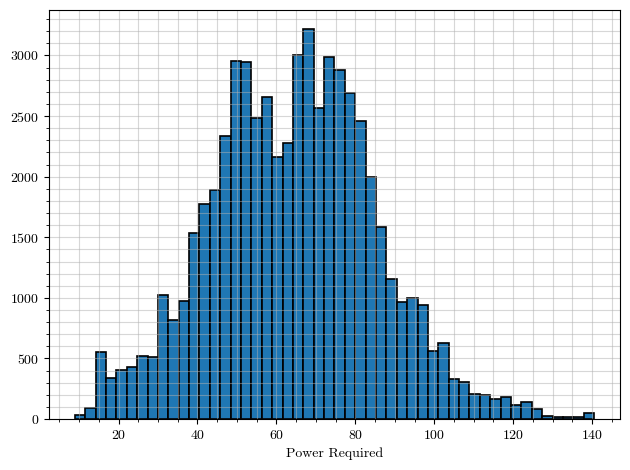

11.20407485961914
0.0


In [ ]:
i = 6

plt.figure()
plt.hist(P_ct[masks[i]], bins=50, edgecolor='black', linewidth=1.2 )
plt.xlabel("Power Required")
plt.show()
print(np.mean(df.Airspeed_Demanded[masks[i]]))
print(np.std(df.Airspeed_Demanded[masks[i]]))

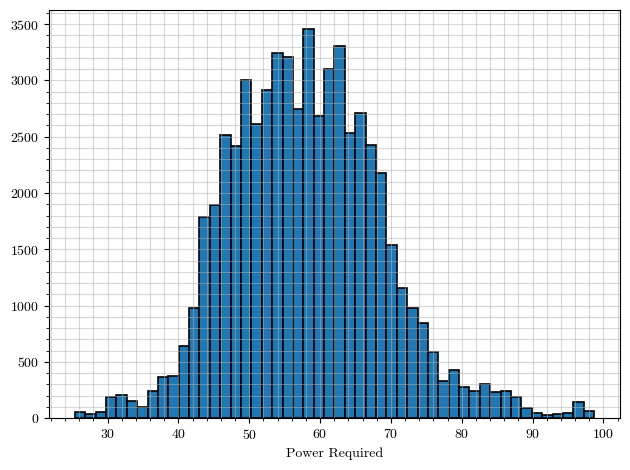

10.185328782773198
0.0062544328066831386


In [ ]:
i = 3

plt.figure()
plt.hist(P_ct[masks[i]], bins=50, edgecolor='black', linewidth=1.2 )
plt.xlabel("Power Required")
plt.show()
print(np.mean(df.Airspeed_Demanded[masks[i]]))
print(np.std(df.Airspeed_Demanded[masks[i]]))

In [ ]:
print(np.std(P_ct[masks[i]]))
print(np.mean(P_ct[masks[i]]))

10.74865915783366
58.067959478218455
